In [73]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

import pickle 
from matplotlib.path import Path
from PIL import Image
import cv2

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from skimage.feature import local_binary_pattern
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import DBSCAN

import glob
import os
import h5py

from collections import Counter

from utils import (
    get_matrix_points, 
    get_coords,
    get_mirror_from_image_color,

)

In [3]:
M_POINTS = get_matrix_points()

In [26]:
EXCLUDE_ID_LIST = [
    0, 1, 2, 3, 13, 14, 15, 16,
    17, 18, 19, 31, 32, 33,
   34, 35, 49, 50,
   51, 67,
   221, 237,
   238, 239,253, 254,
   255, 256, 257,269, 270,271,
   272, 273, 274, 275, 285, 286, 287, 288
]

In [4]:
img_color = Image.open("data/IRCamM1T20250706_144933M.jpg").convert("RGB")
mirrors_color_list = [get_mirror_from_image_color(M_POINTS, i, np.array(img_color)) for i in range(289)]

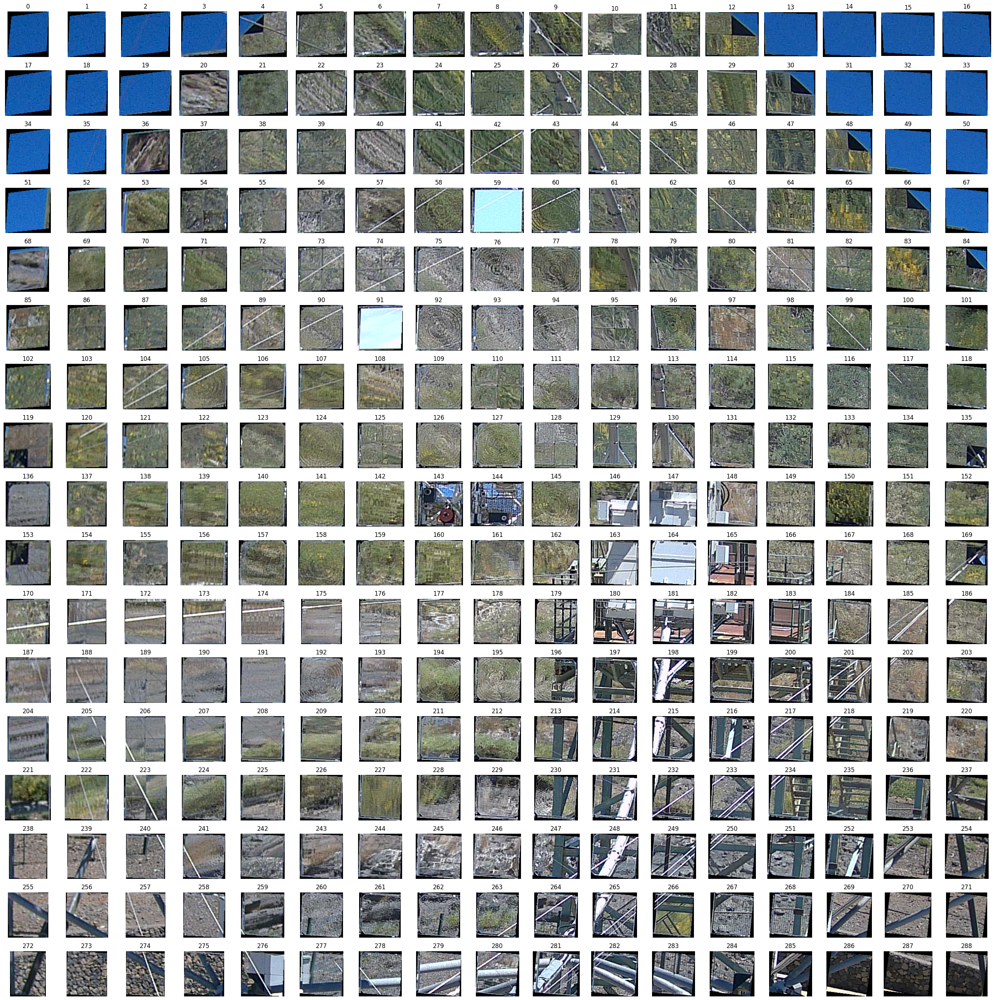

In [5]:
fig, ax = plt.subplots(17, 17, figsize=(28, 28))
ax = ax.flatten()

for i in range(289):
    ax[i].imshow(mirrors_color_list[i])
    ax[i].axis("off")
    ax[i].set_title(i)

plt.tight_layout()
plt.show()

In [29]:
mirrors_color_list[5].shape

(87, 97, 3)

In [49]:
img_array = np.zeros((289, 128, 128, 3), dtype=np.uint8)
for i in range(289):
    if i not in EXCLUDE_ID_LIST:
        img = Image.fromarray(mirrors_color_list[i])
        new_img = img.resize((128, 128))
        img_array[i, :, :, :] = np.asarray(new_img)
    

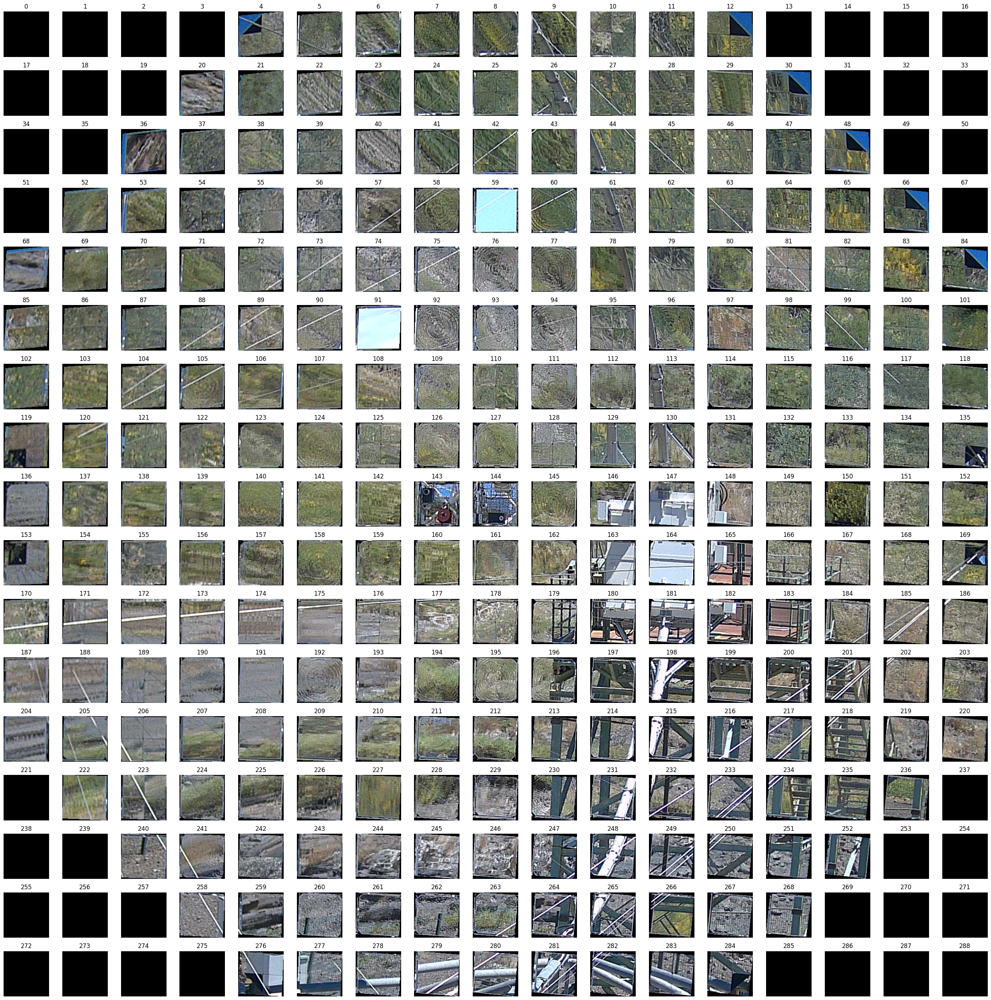

In [52]:
fig, ax = plt.subplots(17, 17, figsize=(28, 28))
ax = ax.flatten()

for i in range(289):
    ax[i].imshow(img_array[i, :, :, :])
    ax[i].axis("off")
    ax[i].set_title(i)

plt.tight_layout()
plt.show()

# Features

In [7]:
def extract_texture_features(image):
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    radius = 2
    n_points = 8 * radius
    lbp = local_binary_pattern(gray_image, n_points, radius, method='uniform')
    (hist, _) = np.histogram(lbp.ravel(), bins=np.arange(0, n_points + 3), range=(0, n_points + 2))
    hist = hist.astype("float")
    hist /= (hist.sum() + 1e-6)
    return hist

def extract_color_features(image):
    """
    Konwertuje obraz do przestrzeni HSV i oblicza histogram kolorów.
    
    Args:
        image (numpy.ndarray): Obraz w formacie BGR (jak wczytuje OpenCV).
        
    Returns:
        numpy.ndarray: Spłaszczony wektor cech z histogramu HSV.
    """
    # Konwersja obrazu z BGR do HSV
    hsv_image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    
    # Obliczenie histogramu dla kanałów H, S, V
    # Definiujemy liczbę przedziałów (bins) dla każdego kanału
    # H: 0-179 (barwa), S: 0-255 (nasycenie), V: 0-255 (jasność)
    hist = cv2.calcHist([hsv_image], [0, 1, 2], None, [8, 4, 4], [0, 180, 0, 256, 0, 256])
    
    # Normalizacja histogramu, aby wartości były w zakresie od 0 do 1
    cv2.normalize(hist, hist)
    
    # Spłaszczenie histogramu do jednowymiarowego wektora cech
    return hist.flatten()

In [11]:
features_list = []
for color_img in mirrors_color_list:
    color_f = extract_color_features(color_img)
    texture_f = extract_texture_features(color_img)
    feature_vector = np.concatenate([color_f, texture_f]) 
    features_list.append(feature_vector)

data = np.array(features_list)

scaler = StandardScaler()
scaled_data = scaler.fit_transform(data)

k = 4
kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
kmeans.fit(scaled_data)
labels = kmeans.labels_

In [16]:
scaler = StandardScaler()
scaled_data = scaler.fit_transform(data)

k = 4
kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
kmeans.fit(scaled_data)
labels = kmeans.labels_

In [17]:
scaled_data.shape

(289, 146)

In [18]:
Counter(labels)

Counter({np.int32(1): 222, np.int32(0): 61, np.int32(3): 5, np.int32(2): 1})

In [21]:
labels_class_1 = np.where(labels == 1)[0][::10]
print(labels_class_1)

[  0  10  21  32  43  53  63  74  86  96 106 116 127 137 149 160 173 188
 203 219 238 255 277]


In [22]:
labels_class_0 = np.where(labels == 0)[0][::2]
print(labels_class_0)

[ 20  36  84 144 163 179 197 199 201 214 216 218 230 232 234 236 247 249
 252 254 264 266 269 272 274 276 280 282 284 286 288]


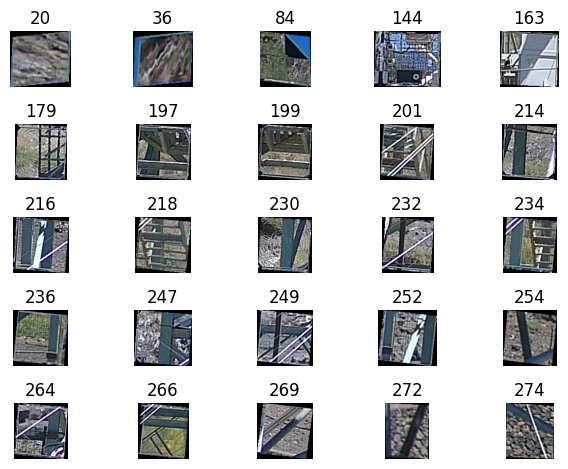

In [23]:
fig, ax = plt.subplots(5, 5)
ax = ax.flatten()
for i, id_mirror in enumerate(labels_class_0[:25]):
    ax[i].imshow(mirrors_color_list[id_mirror])
    ax[i].axis("off")
    ax[i].set_title(id_mirror)

plt.tight_layout()

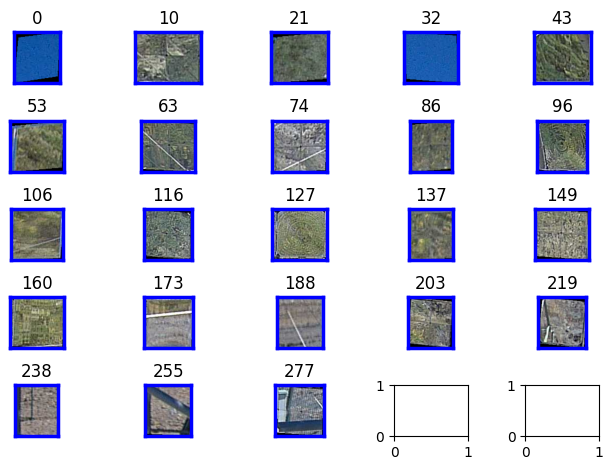

In [24]:
fig, ax = plt.subplots(5, 5)
ax = ax.flatten()
for i, id_mirror in enumerate(labels_class_1[:25]):
    ax[i].imshow(mirrors_color_list[id_mirror])
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(id_mirror)

    for spine in ax[i].spines.values():
        spine.set_edgecolor('blue')
        spine.set_linewidth(2.5)

plt.tight_layout()

In [36]:
for class_id in labels[:5]:
    print(class_id)

1
1
1
1
1


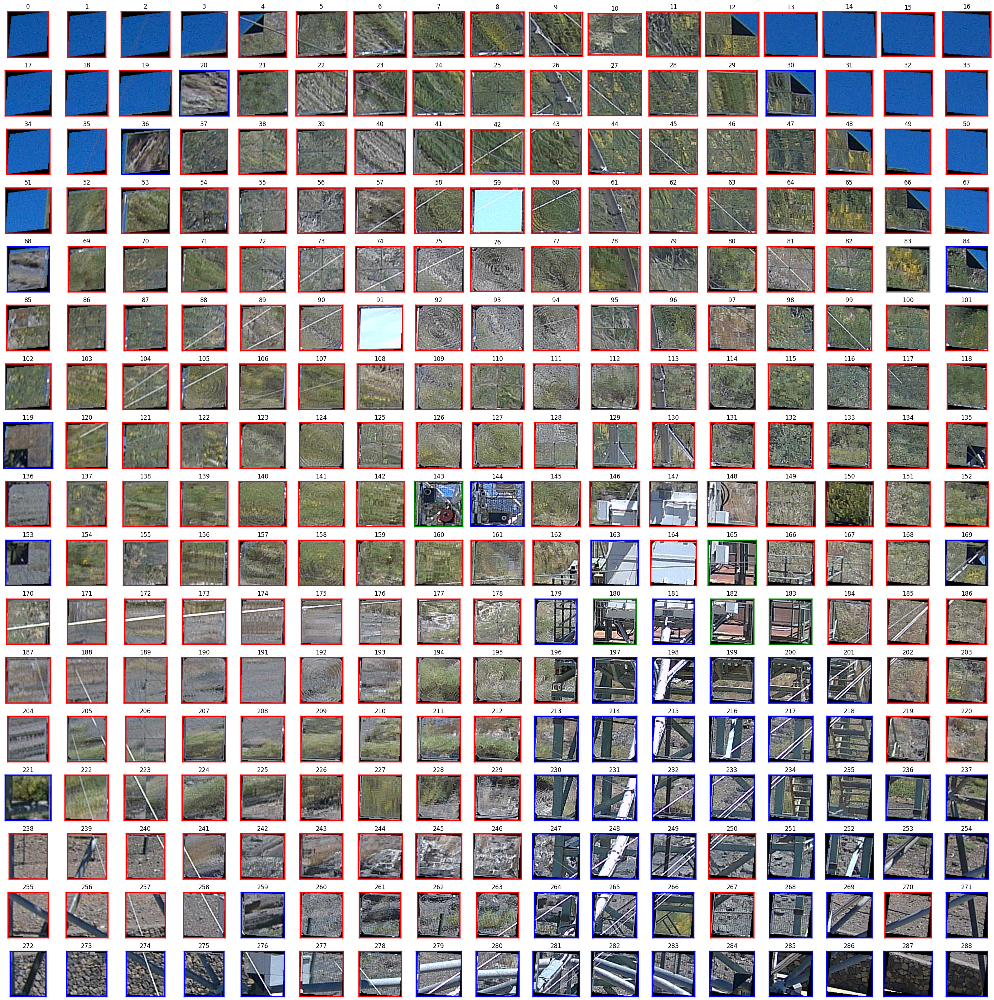

In [25]:
fig, ax = plt.subplots(17, 17, figsize=(28, 28))
ax = ax.flatten()

for i, class_num in enumerate(labels):
    ax[i].imshow(mirrors_color_list[i])
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(i)
    if class_num == 0:
        for spine in ax[i].spines.values():
            spine.set_edgecolor('blue')
            spine.set_linewidth(2.5)
    if class_num == 1:
        for spine in ax[i].spines.values():
            spine.set_edgecolor('red')
            spine.set_linewidth(2.5)
    if class_num == 2:
        for spine in ax[i].spines.values():
            spine.set_edgecolor('gray')
            spine.set_linewidth(2.5)
    if class_num == 3:
        for spine in ax[i].spines.values():
            spine.set_edgecolor('green')
            spine.set_linewidth(2.5)
plt.tight_layout()
plt.show()

In [ ]:
exclude_id_list = [
    0, 1, 2, 3, 13, 14, 15, 16,
    17, 18, 19, 31, 32, 33,
   34, 35, 49, 50,
   51, 67,
   221, 237,
   238, 239,253, 254,
   255, 256, 257,269, 270,271,
   272, 273, 274, 275, 285, 286, 287, 288
]

                   

In [45]:
print(len(mirrors_color_list))
print(mirrors_color_list[2].shape)

289
(93, 100, 3)


In [61]:
features_list = []

for i in range(289):
    color_f = extract_color_features(img_array[i, :, :, :])
    texture_f = extract_texture_features(img_array[i, :, :, :])
    feature_vector = np.concatenate([color_f, texture_f]) 
    features_list.append(feature_vector)

data = np.array(features_list)

scaler = StandardScaler()
scaled_data = scaler.fit_transform(data)

k = 4
kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
kmeans.fit(scaled_data)
labels = kmeans.labels_

In [66]:
Counter(labels)

Counter({np.int32(0): 202, np.int32(3): 42, np.int32(2): 40, np.int32(1): 5})

In [86]:
# eps i min_samples trzeba dobrać eksperymentalnie
dbscan = DBSCAN(eps=0.05, min_samples=3)
labels = dbscan.fit_predict(principal_components)

# Etykieta -1 oznacza szum (outlier)
n_clusters = len(set(labels)) - (1 if -1 in labels else 0)
print(f"DBSCAN znalazł {n_clusters} klastrów.")

DBSCAN znalazł 3 klastrów.


In [87]:
principal_components.shape

(289, 2)

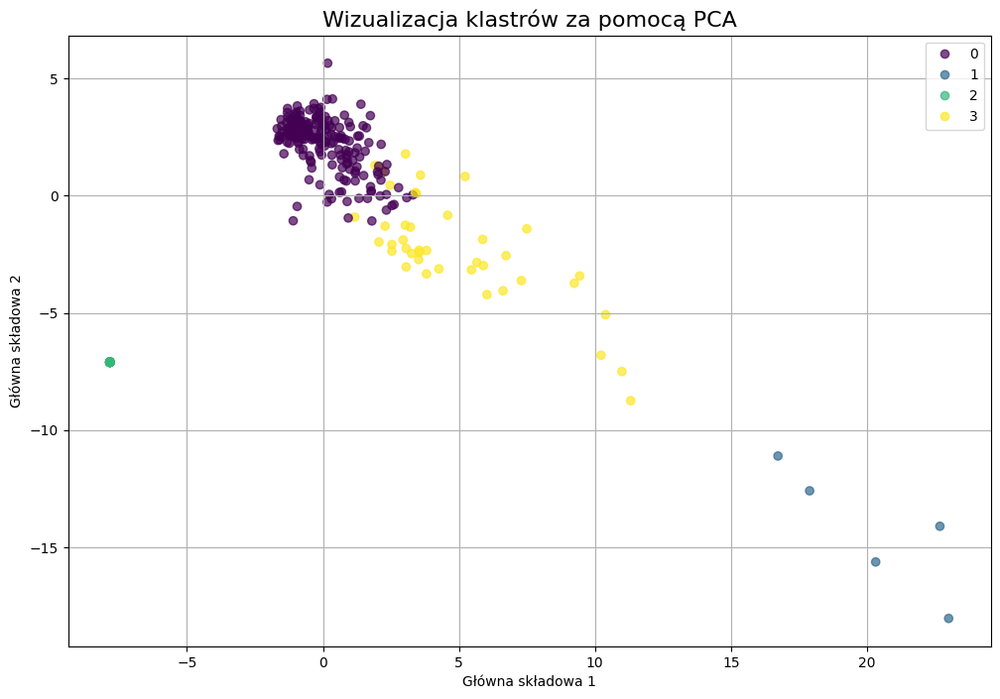

In [68]:
# 1. Redukcja wymiarowości za pomocą PCA
pca = PCA(n_components=2) # Redukujemy do 2 wymiarów
principal_components = pca.fit_transform(scaled_data)

# 2. Tworzenie wykresu punktowego
plt.figure(figsize=(12, 8))
scatter = plt.scatter(principal_components[:, 0], principal_components[:, 1], c=labels, cmap='viridis', alpha=0.7)

# Dodanie tytułów i etykiet
plt.title('Wizualizacja klastrów za pomocą PCA', fontsize=16)
plt.xlabel('Główna składowa 1')
plt.ylabel('Główna składowa 2')

# Dodanie legendy
plt.legend(handles=scatter.legend_elements()[0], labels=range(k))
plt.grid(True)
plt.show()

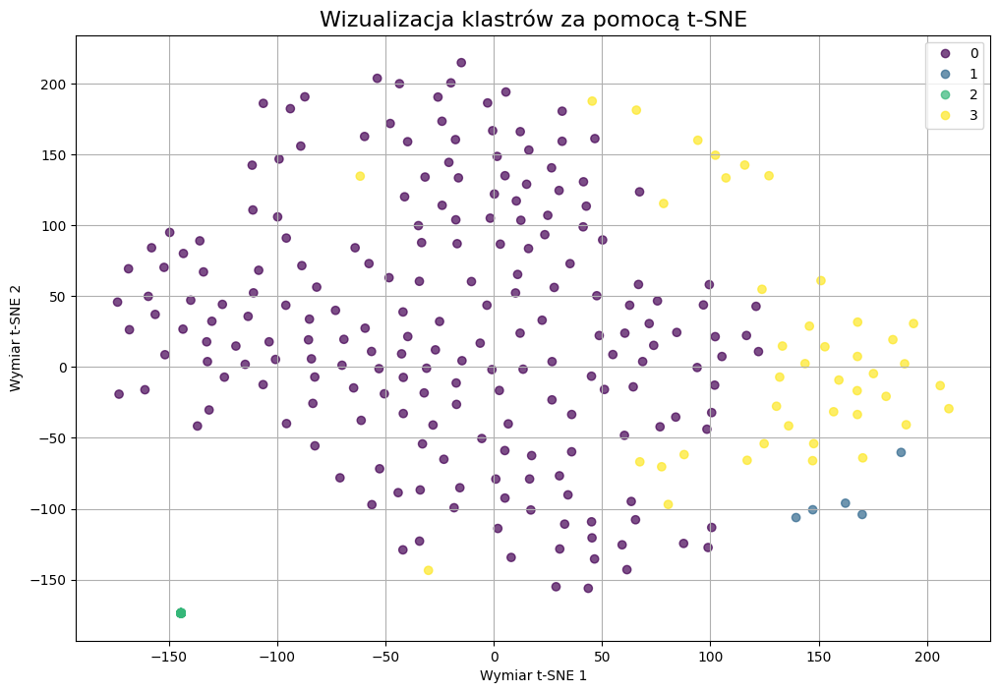

In [72]:
# 1. Redukcja wymiarowości za pomocą t-SNE
# Perplexity to ważny parametr, zwykle ustawia się go w zakresie 5-50.
tsne = TSNE(n_components=2, random_state=42, perplexity=30)
tsne_results = tsne.fit_transform(scaled_data)

# 2. Tworzenie wykresu punktowego
plt.figure(figsize=(12, 8))
scatter = plt.scatter(tsne_results[:, 0], tsne_results[:, 1], c=labels, cmap='viridis', alpha=0.7)

# Dodanie tytułów i etykiet
plt.title('Wizualizacja klastrów za pomocą t-SNE', fontsize=16)
plt.xlabel('Wymiar t-SNE 1')
plt.ylabel('Wymiar t-SNE 2')

# Dodanie legendy
plt.legend(handles=scatter.legend_elements()[0], labels=range(k))
plt.grid(True)
plt.show()

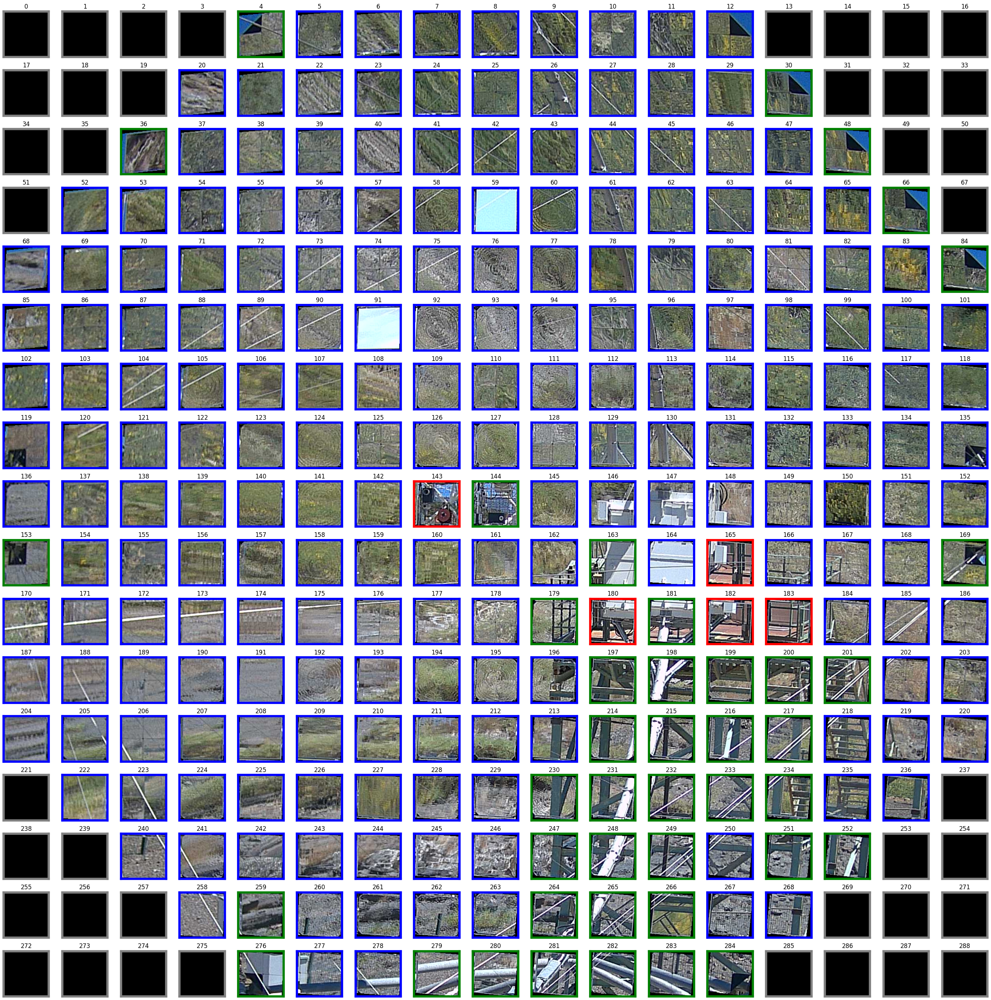

In [65]:
fig, ax = plt.subplots(17, 17, figsize=(28, 28))
ax = ax.flatten()

for i, class_num in enumerate(labels):
    ax[i].imshow(img_array[i, :, :, :])
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(i)
    if class_num == 0:
        for spine in ax[i].spines.values():
            spine.set_edgecolor('blue')
            spine.set_linewidth(4.5)
    if class_num == 1:
        for spine in ax[i].spines.values():
            spine.set_edgecolor('red')
            spine.set_linewidth(4.5)
    if class_num == 2:
        for spine in ax[i].spines.values():
            spine.set_edgecolor('gray')
            spine.set_linewidth(4.5)
    if class_num == 3:
        for spine in ax[i].spines.values():
            spine.set_edgecolor('green')
            spine.set_linewidth(4.5)
plt.tight_layout()
plt.show()